# <center> NYC Wi-Fi Hotspots Analysis: 
##    <center> A Tale of Two Cities


#### <center> by Monica Grant, PhD

### A World of Digital Inclusion

Digital inclusion means that everyone has the opportunity to use digital devices and the internet for various purposes, both personal and professional, on their computer or mobile device. Since 2015, New York City has been trying to become a city of digital inclusion and innovation by installing mobile hotspots, but this may not benefit all New Yorkers equally.

Does this look Familar? 


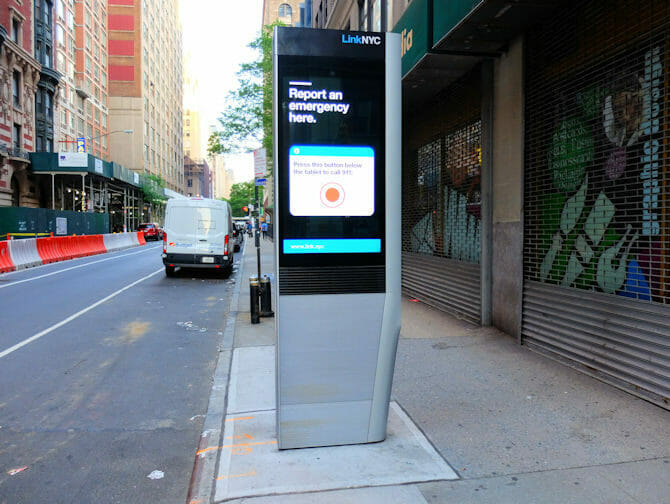

In [167]:
from IPython.display import Image
img = Image(filename='Link NYC.jpg')

print ( "Does this look Familar? ")
img

In [181]:
from IPython.display import Video; 
Video ("Here's How New York City's Free Wifi Program Works.mp4", embed=True,  width=400, height=250)

######  Bloomberg Originals on Youtube "Heres How New York City Free Wi-Fi Works"
https://www.youtube.com/watch?v=yJWtm3nVrYs
       

### <center> Free Wifi For All???... Is it True???

In [8]:
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
import plotly.express as px

In [9]:
df_wifi = pd.read_csv("NYC_Wi-Fi_Hotspot_Locations.csv")

##### Dataset being Reviewed: 
    "NYC Wi-Fi Hotspot Locations" 
     New York Open Data
     Data Provided by: Office of Technology and Innovation (OTI)
     Created:July 14, 2015 Updated:September 26, 2019
     https://data.cityofnewyork.us/City-Government/NYC-Wi-Fi-Hotspot-Locations/yjub-udmw

In [6]:
# pd.set_option('display.max_columns', None)
# pd.set_option('display.max_rows', None)
#to see the full table

In [10]:
df_wifi

,OBJECTID,Borough,Type,Provider,Name,Location,Latitude,Longitude,X,Y,...,BCTCB2010,BIN,BBL,DOITT_ID,"Location (Lat, Long)",Zip Codes,Community Districts,Borough Boundaries,City Council Districts,Police Precincts
0,10604,4,Limited Free,SPECTRUM,Baisley Pond Park,Park Perimeter,40.674860,-73.784120,1.044132e+06,185219.892077,...,294,0,0,1408,"(40.6748599999, -73.7841200005)",24669.0,41.0,3.0,46.0,71.0
1,10555,4,Limited Free,SPECTRUM,Kissena Park,Park Perimeter,40.747560,-73.818150,1.034638e+06,211685.217755,...,845,0,0,1359,"(40.7475599996, -73.8181499997)",14190.0,22.0,3.0,3.0,67.0
2,12370,3,Free,Transit Wireless,Grand St (L),Grand St (L),40.711926,-73.940670,1.000698e+06,198655.908840,...,495,0,0,1699,"(40.7119259997, -73.9406699994)",17613.0,36.0,2.0,30.0,56.0
3,9893,3,Free,Downtown Brooklyn,NaN,125 Court St.,40.689985,-73.991995,9.864700e+05,190656.680416,...,9,3388736,3002777501,298,"(40.6899850001, -73.9919950004)",16865.0,68.0,2.0,38.0,54.0
4,10169,1,Free,Transit Wireless,Lexington Av-63 St (F),Lexington Av-63 St (F),40.764630,-73.966115,9.936366e+05,217853.888161,...,120,0,0,599,"(40.7646300002, -73.9661150001)",10090.0,23.0,4.0,51.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3314,10872,3,Limited Free,SPECTRUM,Carroll Park,Court off Smith St between Carrol St and 1st P...,40.680630,-73.995382,9.855309e+05,187248.314202,...,77,3007547,3004490015,1338,"(40.6806299998, -73.9953819995)",13514.0,14.0,2.0,27.0,48.0
3315,12026,2,Free,LinkNYC - Citybridge,bx-01-138789,312 WILLIS AVENUE,40.810896,-73.921434,1.005999e+06,234718.294065,...,39,2000335,2022850010,4113,"(40.8108964904, -73.9214341701)",10932.0,49.0,5.0,35.0,23.0
3316,12063,3,Free,LinkNYC - Citybridge,bk-01-143982,32 GRAHAM AVENUE,40.701930,-73.942239,1.000265e+06,195013.901033,...,491,3071609,3031200000,3018,"(40.7019303441, -73.9422392381)",17213.0,36.0,2.0,30.0,56.0
3317,12066,3,Free,LinkNYC - Citybridge,bk-17-126527,1339 FLATBUSH AVENUE,40.638560,-73.953603,9.971268e+05,171924.271359,...,790,3120360,3052110060,3021,"(40.6385596088, -73.9536032378)",13510.0,61.0,2.0,26.0,40.0


#### <center> Renaming

In [12]:
df_wifi = df_wifi.rename(columns={'Zip Codes': 'Zip_Codes','Community Districts': 'Community_Districts', 'Police Precincts': 'Police_Precincts', 'City Council Districts': 'City_Council_Districts','Borough Boundaries': 'Borough_Boundaries', 'Borough Name': 'Borough_Name', 'Council Distrcit': 'Council_District', 'Neighborhood Tabulation Area (NTA)': 'Neighborhoods'  })

In [13]:
df_wifi


,OBJECTID,Borough,Type,Provider,Name,Location,Latitude,Longitude,X,Y,...,BCTCB2010,BIN,BBL,DOITT_ID,"Location (Lat, Long)",Zip_Codes,Community_Districts,Borough_Boundaries,City_Council_Districts,Police_Precincts
0,10604,4,Limited Free,SPECTRUM,Baisley Pond Park,Park Perimeter,40.674860,-73.784120,1.044132e+06,185219.892077,...,294,0,0,1408,"(40.6748599999, -73.7841200005)",24669.0,41.0,3.0,46.0,71.0
1,10555,4,Limited Free,SPECTRUM,Kissena Park,Park Perimeter,40.747560,-73.818150,1.034638e+06,211685.217755,...,845,0,0,1359,"(40.7475599996, -73.8181499997)",14190.0,22.0,3.0,3.0,67.0
2,12370,3,Free,Transit Wireless,Grand St (L),Grand St (L),40.711926,-73.940670,1.000698e+06,198655.908840,...,495,0,0,1699,"(40.7119259997, -73.9406699994)",17613.0,36.0,2.0,30.0,56.0
3,9893,3,Free,Downtown Brooklyn,NaN,125 Court St.,40.689985,-73.991995,9.864700e+05,190656.680416,...,9,3388736,3002777501,298,"(40.6899850001, -73.9919950004)",16865.0,68.0,2.0,38.0,54.0
4,10169,1,Free,Transit Wireless,Lexington Av-63 St (F),Lexington Av-63 St (F),40.764630,-73.966115,9.936366e+05,217853.888161,...,120,0,0,599,"(40.7646300002, -73.9661150001)",10090.0,23.0,4.0,51.0,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3314,10872,3,Limited Free,SPECTRUM,Carroll Park,Court off Smith St between Carrol St and 1st P...,40.680630,-73.995382,9.855309e+05,187248.314202,...,77,3007547,3004490015,1338,"(40.6806299998, -73.9953819995)",13514.0,14.0,2.0,27.0,48.0
3315,12026,2,Free,LinkNYC - Citybridge,bx-01-138789,312 WILLIS AVENUE,40.810896,-73.921434,1.005999e+06,234718.294065,...,39,2000335,2022850010,4113,"(40.8108964904, -73.9214341701)",10932.0,49.0,5.0,35.0,23.0
3316,12063,3,Free,LinkNYC - Citybridge,bk-01-143982,32 GRAHAM AVENUE,40.701930,-73.942239,1.000265e+06,195013.901033,...,491,3071609,3031200000,3018,"(40.7019303441, -73.9422392381)",17213.0,36.0,2.0,30.0,56.0
3317,12066,3,Free,LinkNYC - Citybridge,bk-17-126527,1339 FLATBUSH AVENUE,40.638560,-73.953603,9.971268e+05,171924.271359,...,790,3120360,3052110060,3021,"(40.6385596088, -73.9536032378)",13510.0,61.0,2.0,26.0,40.0


To see all data cleaning and evaluation go to >>>> https://github.com/TheeDMG/NYC-Wifi-Hotspots/blob/8656f623d7127cc06cbe07bd0baf3a4b342b5821/Cleaning%20and%20Evaluating%20NYC%20Wi-Fi%20Hotspots%20_%20Monica%20Grant.ipynb

## <center> Where are the Hotspots? 


### Types of Locations

In [80]:
df_wifi.Location_T.value_counts()

Outdoor Kiosk                                   1867
Outdoor                                          699
Subway Station                                   276
Library                                          214
Indoor                                           126
Outdoor TWC Aerial                               121
Indoor AP - North Maintenance Area                 3
Indoor AP - South Maintenance Area                 3
Indoor AP - North Management Office                2
Indoor AP - South Management Office                2
Indoor AP - Community Center - Gym                 1
Indoor AP - Community Center - Activity Rm 2       1
Indoor AP - Community Center - Activity Rm 1       1
Indoor AP - Community Center - Computer Rm         1
Indoor AP - Queens Public Library                  1
Indoor AP - Community Center - Cafeteria           1
Name: Location_T, dtype: int64

In [36]:
df_wifi.Location_T.value_counts(normalize=True).mul(100).round(2).astype(str) + '%'

Outdoor Kiosk                                   56.25%
Outdoor                                         21.06%
Subway Station                                   8.32%
Library                                          6.45%
Indoor                                            3.8%
Outdoor TWC Aerial                               3.65%
Indoor AP - North Maintenance Area               0.09%
Indoor AP - South Maintenance Area               0.09%
Indoor AP - North Management Office              0.06%
Indoor AP - South Management Office              0.06%
Indoor AP - Community Center - Gym               0.03%
Indoor AP - Community Center - Activity Rm 2     0.03%
Indoor AP - Community Center - Activity Rm 1     0.03%
Indoor AP - Community Center - Computer Rm       0.03%
Indoor AP - Queens Public Library                0.03%
Indoor AP - Community Center - Cafeteria         0.03%
Name: Location_T, dtype: object

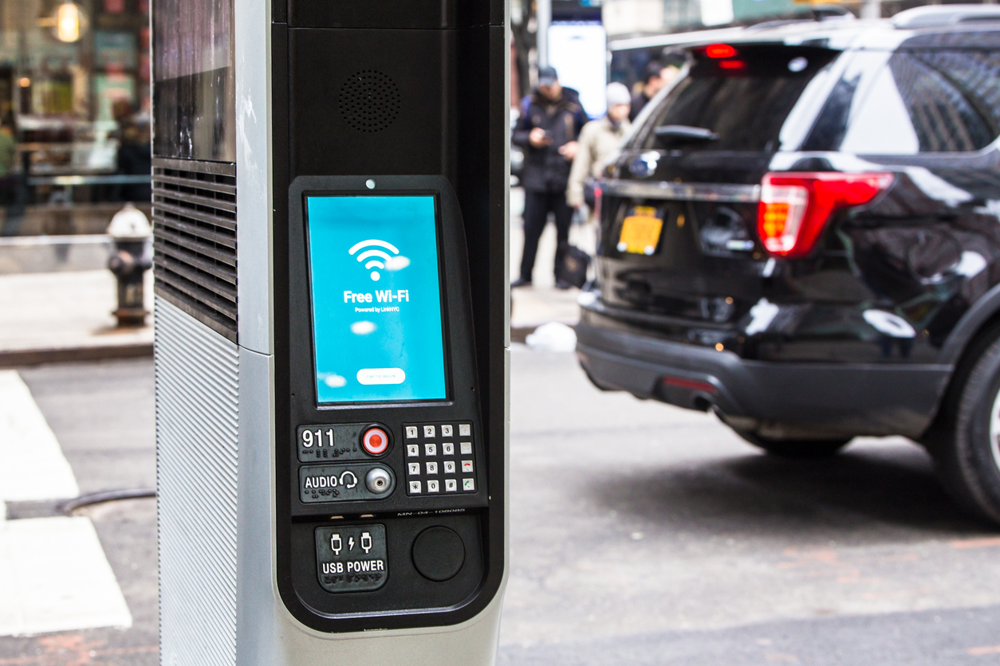

In [173]:
from IPython.display import Image
img = Image(filename='NYC Wifi Hotspot.jpg')
img

# <Center> NYC Wifi Hotspots are ... 
   <Center> Outdoor 81% 
   <Center> Subway 8.3 %
   <Center> Library 6.4 %
   <Center> Indoor 4 %

### NYC Boroughs

In [62]:
#How many Hotspots per Borough

df_wifi.Borough_Name.value_counts()

Manhattan        1672
Brooklyn          700
Queens            531
Bronx             316
Staten Island     100
Name: Borough_Name, dtype: int64

In [64]:
# Whats that in percentages? 

df_wifi.Borough_Name.value_counts(normalize=True).mul(100).round(2).astype(str) + '%'  #Percentages

Manhattan        50.38%
Brooklyn         21.09%
Queens            16.0%
Bronx             9.52%
Staten Island     3.01%
Name: Borough_Name, dtype: object

Text(0.5, 1.0, 'NYC Wifi Hotspots in Boroughs ')

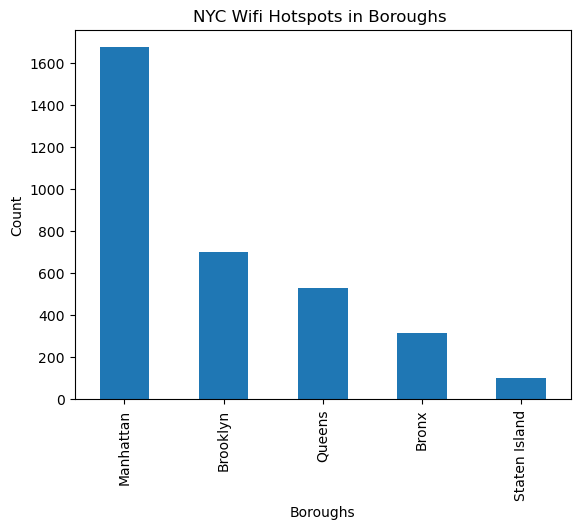

In [66]:
# lets put it on a chart
borough_counts = df_wifi.Borough_Name.value_counts()

#chart
borough_counts.plot(kind='bar')

plt.xlabel('Boroughs')
plt.ylabel('Count')
plt.title('NYC Wifi Hotspots in Boroughs ')

### NYC Neighborhoods

In [19]:
df_wifi.Neighborhoods.value_counts()

Midtown-Midtown South                               160
Hudson Yards-Chelsea-Flatiron-Union Square          156
Upper West Side                                     143
DUMBO-Vinegar Hill-Downtown Brooklyn-Boerum Hill    125
Turtle Bay-East Midtown                             111
                                                   ... 
Pomonok-Flushing Heights-Hillcrest                    1
Rugby-Remsen Village                                  1
Laurelton                                             1
Rosedale                                              1
Homecrest                                             1
Name: Neighborhoods, Length: 179, dtype: int64

In [172]:
df_wifi.Neighborhoods.value_counts().head(20)


Midtown-Midtown South                               160
Hudson Yards-Chelsea-Flatiron-Union Square          156
Upper West Side                                     143
DUMBO-Vinegar Hill-Downtown Brooklyn-Boerum Hill    125
Turtle Bay-East Midtown                             111
Central Harlem North-Polo Grounds                   101
Murray Hill-Kips Bay                                 82
Central Harlem South                                 69
East Harlem North                                    65
Hamilton Heights                                     63
SoHo-TriBeCa-Civic Center-Little Italy               58
East Village                                         58
Astoria                                              54
Upper East Side-Carnegie Hill                        54
Hunters Point-Sunnyside-West Maspeth                 52
Battery Park City-Lower Manhattan                    52
Lincoln Square                                       52
Lenox Hill-Roosevelt Island                     

Text(0.5, 1.0, 'Top 20 Neighborhoods for Wifi Hotspot')

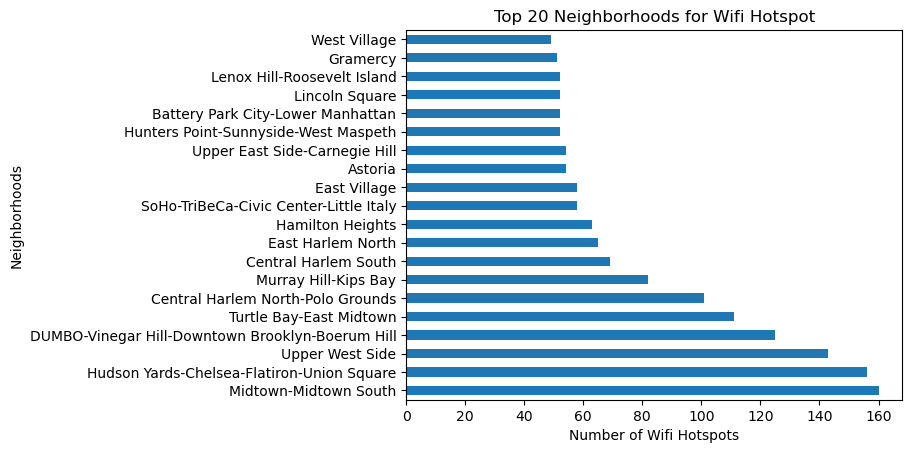

In [61]:
# Which Neighborhoods have the Most Hotspots
df_Neighborhoods=df_wifi.Neighborhoods.value_counts().head(20)

#Make the chart
df_Neighborhoods.plot(kind='barh')

plt.xlabel('Number of Wifi Hotspots')
plt.ylabel('Neighborhoods')
plt.title('Top 20 Neighborhoods for Wifi Hotspot')

Text(0.5, 1.0, 'Top 30 Neighborhoods for Wifi Hotspot')

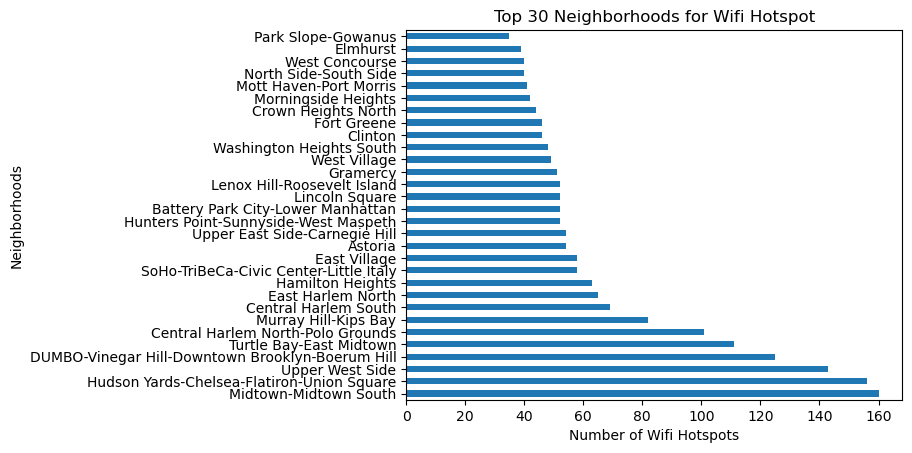

In [60]:
#Where is the Bronx... add a few more rows until something appears
df_Neighborhoodsbronx=df_wifi.Neighborhoods.value_counts().head(30)


#make the chart
df_Neighborhoodsbronx.plot(kind='barh')

plt.xlabel('Number of Wifi Hotspots')
plt.ylabel('Neighborhoods')
plt.title('Top 30 Neighborhoods for Wifi Hotspot')

In [ ]:
#Mott Haven is 26th and West Concourse is 28th

## <Center> Wifi Service

### Types of Service (Free or Limited Free)

In [37]:
df_wifi.Type.value_counts()

Free            2736
Limited Free     581
Partner Site       2
Name: Type, dtype: int64

In [38]:
df_wifi.Type.value_counts(normalize=True).mul(100).round(2).astype(str) + '%'

Free            82.43%
Limited Free    17.51%
Partner Site     0.06%
Name: Type, dtype: object

Text(0.5, 1.0, ' Types of Wi-fi Service Available')

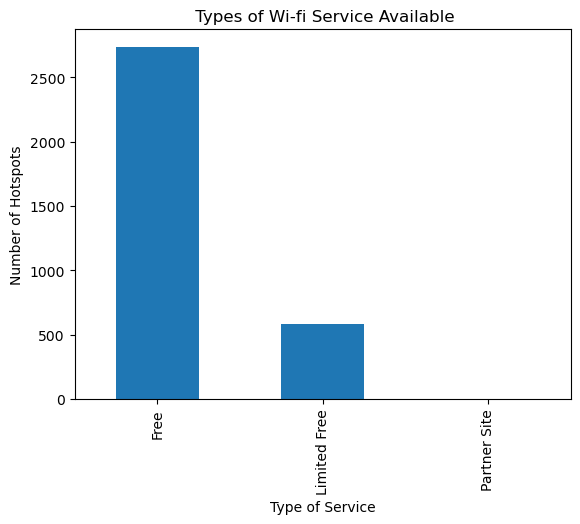

In [52]:
df_servicetype=df_wifi.Type.value_counts()

#Make the Chart

df_servicetype.plot(kind='bar')

plt.xlabel('Type of Service')
plt.ylabel('Number of Hotspots')
plt.title(' Types of Wi-fi Service Available')

### Internet Service Providers  

In [45]:
df_wifi.Provider.value_counts()

LinkNYC - Citybridge       1868
SPECTRUM                    343
Transit Wireless            276
ALTICEUSA                   237
Harlem                      101
Downtown Brooklyn           100
NYPL                         90
QPL                          65
BPL                          59
Manhattan Down Alliance      36
Chelsea                      30
Fiberless                    30
NYCHA                        28
AT&T                         27
Spot On Networks             16
City Tech                    11
Partner                       2
Name: Provider, dtype: int64

In [46]:
df_wifi.Provider.value_counts(normalize=True).mul(100).round(2).astype(str) + '%'

LinkNYC - Citybridge       56.28%
SPECTRUM                   10.33%
Transit Wireless            8.32%
ALTICEUSA                   7.14%
Harlem                      3.04%
Downtown Brooklyn           3.01%
NYPL                        2.71%
QPL                         1.96%
BPL                         1.78%
Manhattan Down Alliance     1.08%
Chelsea                      0.9%
Fiberless                    0.9%
NYCHA                       0.84%
AT&T                        0.81%
Spot On Networks            0.48%
City Tech                   0.33%
Partner                     0.06%
Name: Provider, dtype: object

Text(0.5, 1.0, 'NYC Wifi Service Providers')

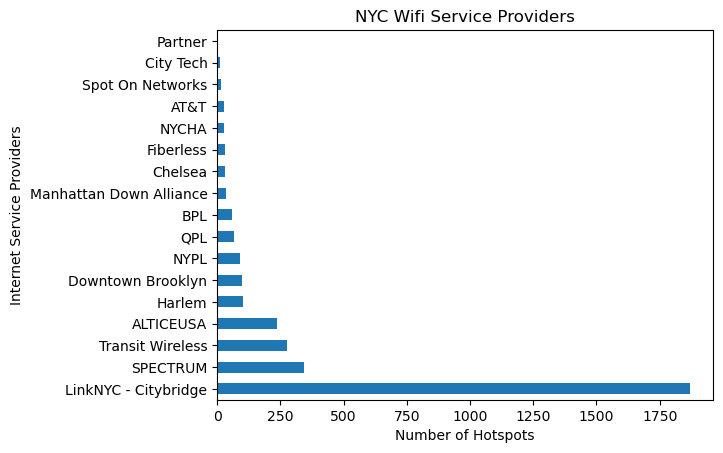

In [50]:
nyc_provider_counts = df_wifi.Provider.value_counts()  


#make the chart
df_wifi.Provider.value_counts().plot(kind='barh')  

plt.xlabel('Number of Hotspots')
plt.ylabel('Internet Service Providers')
plt.title('NYC Wifi Service Providers')


 ### Borough and Internet Services Providers (ISP)

In [158]:
# pivot_df_BP = df_wificompare.pivot_table(
#     index= ['Provider'],
#     columns='Type',
#     values='count',
#     aggfunc='count'
# )

Text(0.5, 1.0, ' Comparing ISPs : Hotspots and Types of Service  ')

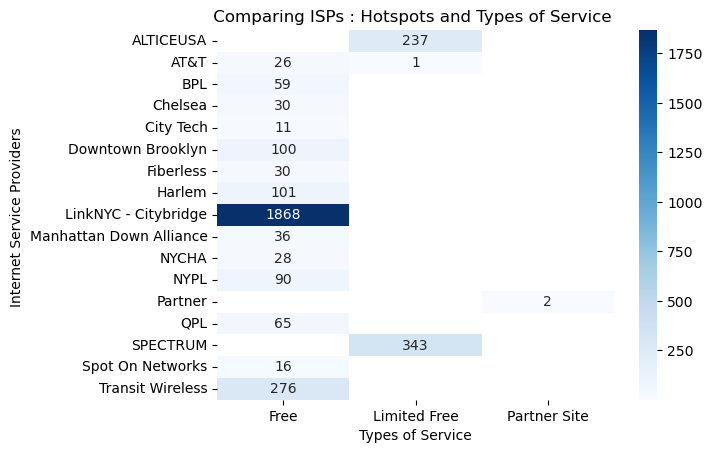

In [161]:
sns.heatmap(pivot_df_BP, cmap='Blues', annot=True, fmt='.0f')
plt.xlabel('Types of Service')
plt.ylabel('Internet Service Providers ')
plt.title(' Comparing ISPs : Hotspots and Types of Service  ')


 ### Borough and Services Types 

In [151]:
df_wificompare = df_wifi[['Borough_Name', 'Neighborhoods' , 'Location', 'Postcode','Council_District', 'Type', 'Provider' , 'SSID']].copy()

Text(0.5, 1.0, 'NYC Wifi Hotspots: Type of Service in Boroughs ')

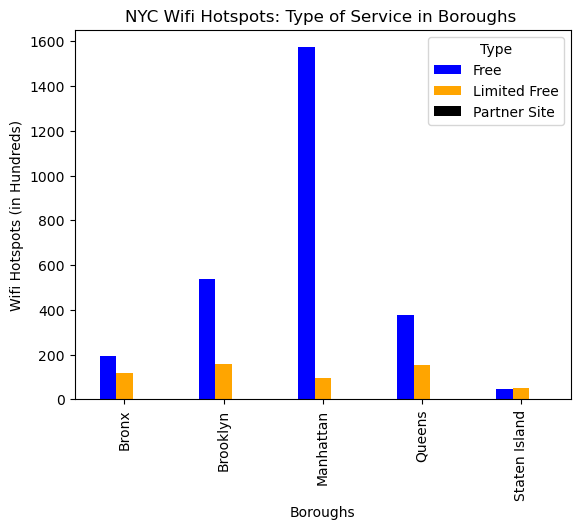

In [152]:
pivot_df_wificompare.plot(kind='bar',color=['blue', 'orange', 'black'])
plt.xlabel('Boroughs')
plt.ylabel('Wifi Hotspots (in Hundreds)')
plt.title('NYC Wifi Hotspots: Type of Service in Boroughs ')

Text(0.5, 1.0, 'NYC Wifi Hotspots: Type of Service in Boroughs ')

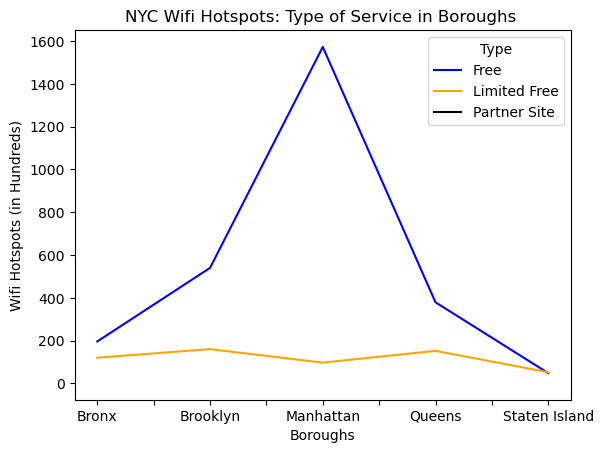

In [153]:
pivot_df_wificompare.plot(kind='line', color=['blue', 'orange', 'black'])
plt.xlabel('Boroughs')
plt.ylabel('Wifi Hotspots (in Hundreds)')
plt.title('NYC Wifi Hotspots: Type of Service in Boroughs ')

Text(0.5, 1.0, 'Wifi Types per Borough ')

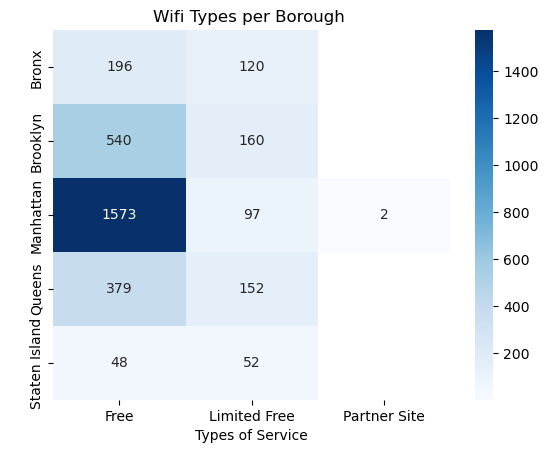

In [105]:
sns.heatmap(pivot_df_wificompare, cmap='Blues', annot=True, fmt='.0f')
plt.xlabel('Types of Service')
plt.ylabel(' ')
plt.title('Wifi Types per Borough ')

#  <center> What about everyone else?
    
###    <center>"Far and Few in Between"


Text(0.5, 1.0, 'Bottom 25 Neighborhoods for Wifi Hotspot')

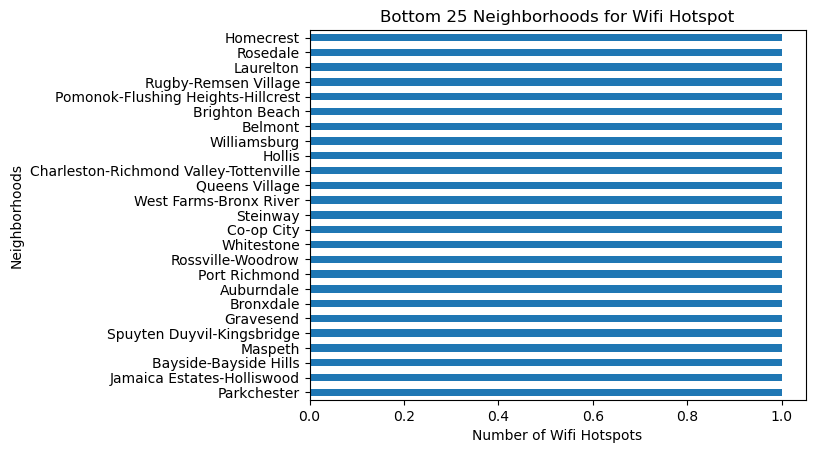

In [58]:
# Which Neighborhoods are at the bottom of the list 

df_Neighborhoodstail=df_wifi.Neighborhoods.value_counts().tail(25)

#Make the Chart
df_Neighborhoodstail.plot(kind='barh')

plt.xlabel('Number of Wifi Hotspots')
plt.ylabel('Neighborhoods')
plt.title('Bottom 25 Neighborhoods for Wifi Hotspot')

Text(0.5, 1.0, 'Bottom 50-25 Neighborhoods for Wifi Hotspot')

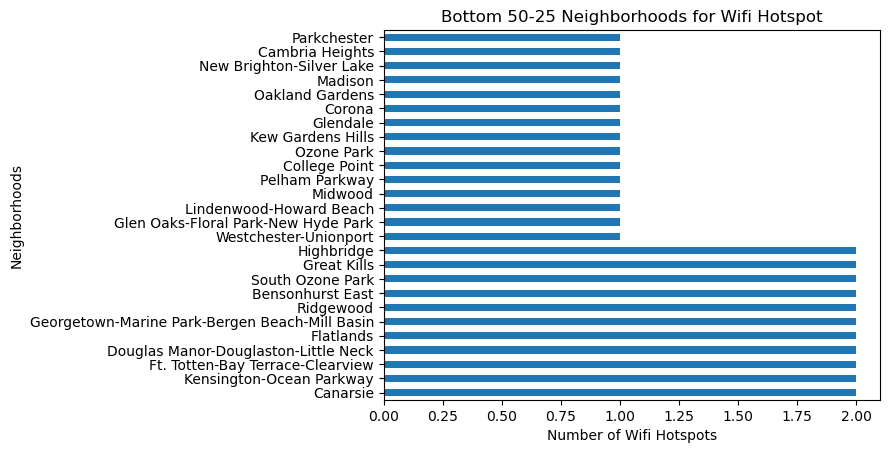

In [57]:
#What Neighborhoods are above the bottom 25 

df_Neighborhoodsmiddle=df_wifi.Neighborhoods.value_counts().tail(50).head(26)

#Make the Chart 
df_Neighborhoodsmiddle.plot(kind='barh')

plt.xlabel('Number of Wifi Hotspots')
plt.ylabel('Neighborhoods')
plt.title('Bottom 50-25 Neighborhoods for Wifi Hotspot')

## <center> Map of NYC Hotspots

In [183]:
fig = px.scatter_geo(df_wifi, lat='Latitude', lon='Longitude' )
fig.update_layout(title='Overview of Wifi Hotspots in NYC')
fig.update_geos(fitbounds= 'geojson', projection_type='winkel tripel', visible=True)

fig.show()

#### Can you see Manattan from here? 

## <center> Whats going on??? 

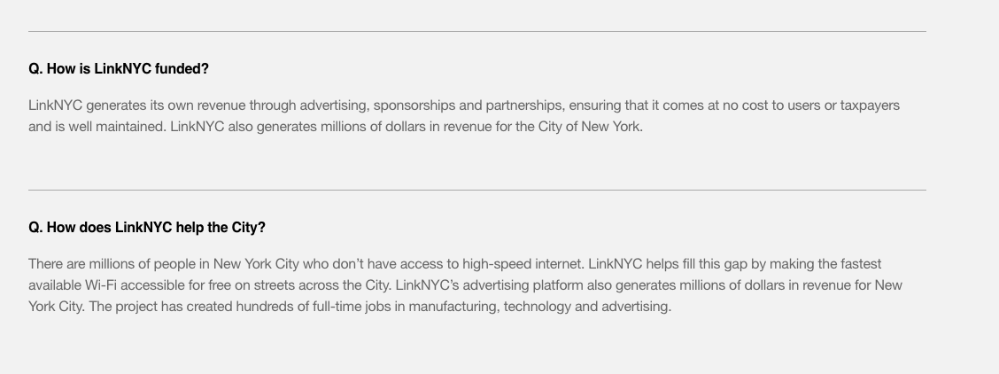

In [131]:
#look closer at LinkNYC's Website
from IPython.display import Image
img = Image(filename='Link NYC funding.png')
img



" LinkNYC generates its own revenue through advertising, sponsorships and partnerships, ensuring that it comes at no cost to users or taxpayers and is well maintained. LinkNYC also generates millions of dollars in revenue for the City of New York." 
Source (https://www.link.nyc/faq.html)

## <Center> Conclusion: 

New York City has a long way to go to achieve Digital Inclusion for all New Yorkers, 
but there have been some nice updates since this data was collected. 


## Updates 

2020

January: Mayor Deblasio office released the NYC Internet Master Plan stating "The internet is essential. As daily life in our city increasingly requires broadband connectivity, every New Yorker must be able to access and use the internet to its full potential." 
NYC Internet Master Plan ( https://communitynets.org/sites/www.muninetworks.org/files/NYC%20master%20plan.pdf ) 


2021

April: Gov. Cuomo passed state law mandateding all ISP's to create a $15/mo plan for low-income residents. 
Source (https://www.govtech.com/network/new-york-mandates-15-a-month-broadband-for-low-income-users.html )

October: Mayor Deblasio reaffirmed his support for the NYC Internet Master Plan, with aims to build public internet infrastructure offering free internet access to 1.6 million New Yorkers. The city planned to invest $157 million in this project. Mayor Deblasio stated that “Broadband isn’t a luxury, it’s a necessity.”

Source (https://www.nyc.gov/office-of-the-mayor/news/724-21/new-york-city-close-digital-divide-1-6-million-residents-advance-racial-equity )


2022

Mayor Adams merged all the city agencies that deal with technology into one new organization called the Office of Technology and Innovation (OTI). He also promised to make sure that every neighborhood in the city has access to fast and reliable 5G internet service and to make NYC a leading city for innovation.

Source (https://www.nyc.gov/assets/oti/downloads/pdf/about/strategic-plan-2022.pdf)




## <center> Recommendations: 

To further explore this topic, 

1) I suggest looking at the latest data on hotspot installations and 
comparing it with the internet service availability in different neighborhoods. 
This can help evaluate the effectiveness of the policies implemented by Deblasio and Adams. 

2) I also suggest examining how free wifi affects various aspects of neighborhood development, 
such as income, education, e-commerce, health and quality of life.

3) If New Yorker's would like true Internet for All People they can reach out to their City Council Office and join a community based organization that advocates for digital inclusion.

## <center> Resources: 

### Want to Help More New Yorker's Get Access? 

NYC Mesh is a volunteer based organization "dedicated to ending the digital divide 
and extending high-speed, reliable internet to all New Yorkers."

https://www.nycmesh.net/

### CyberSecurity Tips

Installing more wifi hotspots in the City can expose our data and privacy to more risks. 
Here are some tips to protect yourself when connecting to a public hotspot:

    1) Avoid entering sensitive information, such as passwords, bank details, or personal data, on a public network.
    
    2) Know the name of the network (SSID) you are connecting to and that it is trustworthy. See graph below 
    
    3) forget the network after each use. Do not let your device automatically connect to familiar networks. 
    
    4) Use a virtual private network (VPN) to hide and encrypt your data.

##### Most Common Wireless Network Names (SSID)

Text(0.5, 1.0, 'Top 10 Wireless Networks')

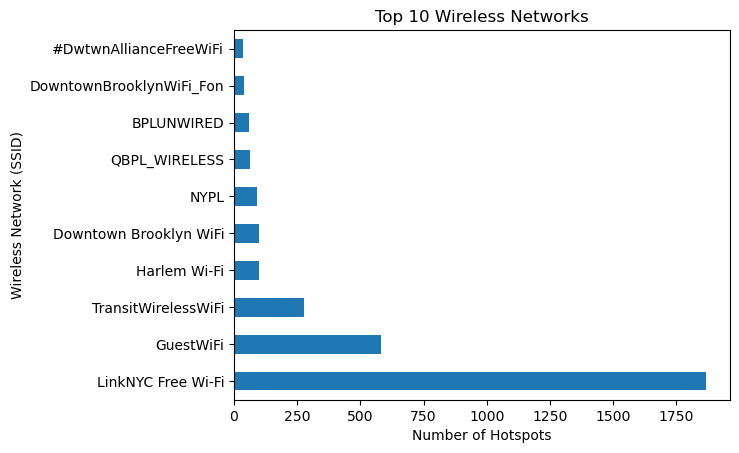

In [146]:
df_ssid=df_wifi.SSID.value_counts().head(10)
df_ssid.plot(kind='barh')

plt.xlabel('Number of Hotspots')
plt.ylabel('Wireless Network (SSID)')
plt.title('Top 10 Wireless Networks')

#### About the Data Analyst: 
    Monica Grant, Phd 
    President
    Reocomm Technology, Energy & Maritime Group 
    reocommtemgroup.com       
    mgrant@reocommtemgroup.com 
    https://www.linkedin.com/in/iamdrmonicagrant/
    https://github.com/TheeDMG